In [1]:
import numpy as np
import pandas as pd
import networkx as nx

import colorsys

def pseudocolor(val):
    h = (1.0 - val) * 120 / 360
    r, g, b = colorsys.hsv_to_rgb(h, 1., 1.)
    return r * 255, g * 255, b * 255

In [2]:
%matplotlib inline

import matplotlib.pyplot as plt
from collections import Counter
from bokeh.plotting import figure, show
from bokeh.resources import CDN
from bokeh.io import output_notebook
output_notebook( resources=CDN )

pd.set_option('max_colwidth', 200)

Loading BokehJS ...

In [3]:
import pickle as pkl

# London's tube graph
oystergraph = nx.read_gpickle("London.gpickle")

# Collections of locations of the London's tube stations: longitude, latitude
with open('locations.pickle', 'rb') as handle:
    locations = pkl.load(handle)
    
# Centrality of each station with nx.degree_centrality(...)
with open('centrality.pickle', 'rb') as handle:
    centrality = pkl.load(handle)

In [4]:
pkl_file = open('names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]

In [5]:
Stations.values()

dict_values(['Mile End', 'Liverpool Street', 'Aldgate East', 'Tower Hill', 'Bank', 'West Ham', 'Canary Wharf', 'Stepney Green', 'Bethnal Green', 'Whitechapel', 'Bermondsey', 'Bromley By Bow', 'North Greenwich', 'London Bridge', 'Monument', 'Canada Water', 'Stratford', 'Aldgate', 'Bow Road', 'Canning Town', 'Mile End', 'Liverpool Street', 'Aldgate East', 'Tower Hill', 'Bank', 'West Ham', 'Canary Wharf', 'Stepney Green', 'Bethnal Green', 'Whitechapel', 'Bermondsey', 'Bromley By Bow', 'North Greenwich', 'London Bridge', 'Monument', 'Canada Water', 'Stratford', 'Aldgate', 'Bow Road', 'Canning Town'])

In [6]:
from bokeh.plotting import figure, show, output_file
from bokeh.models import Title
from bokeh.io import export_png

p = figure(
    x_range = (-0.100, 0.015),
    y_range = (51.495, 51.55),
    height= 500,
    width= 900,
    y_axis_label='Latitude',
    x_axis_label='Longitude'
)
for edge in oystergraph.edges():
    p.line( 
        x= [locations[pt][0] for pt in edge],
        y= [locations[pt][1] for pt in edge],
    )
    
# p.line( 
#     x= [0.023, 0.023],
#     y= [51.525, 51.561],
#     color='red'
# )
# p.line( 
#     x= [0.023, 0.25],
#     y= [51.525, 51.525],
#     color='red'
# )
# p.line( 
#     x= [0.023, 0.25],
#     y= [51.561, 51.561],
#     color='red'
# )
# p.line( 
#     x= [  0.25, 0.25],
#     y= [51.525, 51.561],
#     color='red'
# )

for node in oystergraph.nodes():
    
    if node in Stations.values():
        x = [locations[node][0]]
        y = [locations[node][1]]
        p.circle(
            x, y, 
            radius = .0005+.0025*centrality[node], 
            fill_color = pseudocolor(centrality[node]), 
            line_alpha=0)
    
        p.text(
            x, y, 
            text = {'value':node}, 
            text_font_size = str(8) + "pt", 
            text_align='center',
            text_font_style='bold')           
    
    else:
        x = [locations[node][0]]
        y = [locations[node][1]]
        p.circle(
            x, y, 
            radius = .0005+.0025*centrality[node], 
            fill_color = pseudocolor(centrality[node]), 
            line_alpha=0,
            alpha=0.3)
        
        p.text(
            x, y, 
            text = {'value':node}, 
            text_font_size = str(2+min(centrality[node] * 2, 10)) + "pt", 
            text_align='center',
            text_font_style='bold',
            alpha= 0.3)
        
#     if ((float(x[0])<0.24) & (float(x[0])>0.025)) & ((float(y[0])<51.56) & (float(y[0])>51.525)):
#         p.text(
#             x, y, 
#             text = {'value':node}, 
#             text_font_size = str(4+min(centrality[node] * 8, 10)) + "pt", 
#             text_align='center',
#             text_font_style='bold')        
    
    
    
p.xaxis.visible = False
p.yaxis.visible = False
p.add_layout(Title(text="London's tube", align="center"), "above")
show(p)
# export_png(p, filename=r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\londonnet.png')

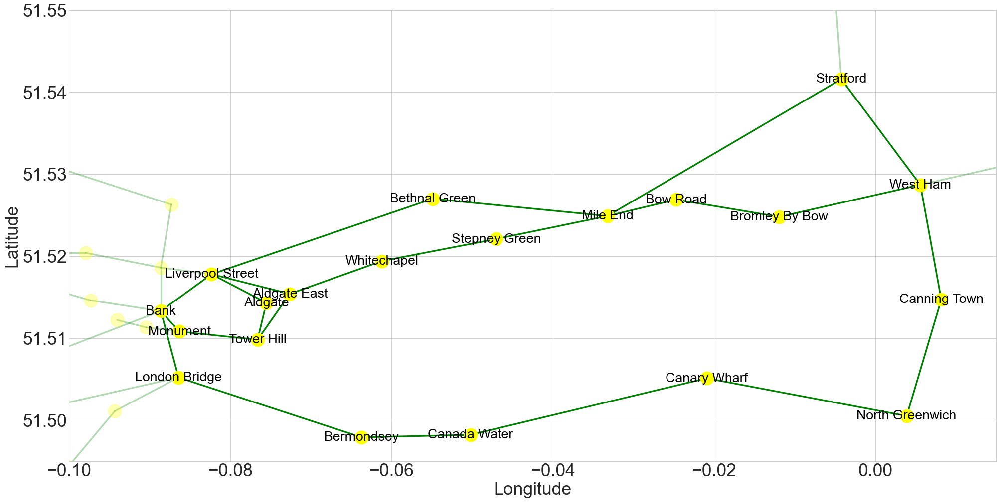

In [7]:
plt.style.use('seaborn-whitegrid')

fig, (london ) = plt.subplots(nrows=1, ncols=1, dpi=80, figsize=(30, 15), sharey=True)

london.set_xlabel('Longitude', fontsize=32)
london.set_ylabel('Latitude', fontsize=32)
london.set_xlim([-0.100, 0.015])
london.set_ylim([51.495, 51.55])



#london.set_title("London's tube network", fontsize=32)

london.xaxis.set_tick_params(labelsize=32)
london.yaxis.set_tick_params(labelsize=32)

for edge in oystergraph.edges():
    
    if (edge[0] in oystergraph.nodes()) & (edge[1] in oystergraph.nodes()):
        x= [locations[pt][0] for pt in edge]
        y= [locations[pt][1] for pt in edge]
    
    if (edge[0] in Stations.values()) & (edge[1] in Stations.values()):
        london.plot(x,y, color='green',linewidth=3)
    else:
        london.plot(x,y, color='green',linewidth=3, alpha = 0.3)


for node in oystergraph.nodes():
    x = [locations[node][0]]
    y = [locations[node][1]]
    size = [centrality[node]]
    
    
    if node in Stations.values():
        london.plot(x, y, marker ='o', markersize= 24, color= 'yellow')
        london.text(x[0], y[0], s= str(node), fontsize = 24, horizontalalignment='center', verticalalignment='center', color='black',rotation=0)    

    else:
        london.plot(x, y, marker ='o', markersize= 24, color= 'yellow', alpha = 0.3)
        
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\londonnet.pdf', format='pdf', dpi = 200, bbox_inches='tight')
        

## New part of the graph to analyse

In [8]:
lanepart = nx.shortest_path(oystergraph, 'West Ham', 'Bank') 
lanepart = lanepart + nx.shortest_path(oystergraph, 'Canning Town', 'London Bridge') 
lanepart = lanepart + nx.shortest_path(oystergraph, 'Mile End', 'Whitechapel')
lanepart = lanepart + ["Aldgate", "Aldgate East", "Tower Hill", "Monument", "Stratford", "Bow Road", "Bromley By Bow"]

In [9]:
lanepartgraph = oystergraph.subgraph(lanepart)

In [10]:
from bokeh.plotting import figure, show, output_file
from bokeh.models import Title

p = figure(
    x_range = (-0.1,.03),
    y_range = (51.49,51.545),
    height= 500,
    width= 900,
    y_axis_label='Latitude',
    x_axis_label='Longitude'
)
for edge in lanepartgraph.edges():
    p.line( 
        x= [locations[pt][0] for pt in edge],
        y= [locations[pt][1] for pt in edge],
    )

for node in lanepartgraph.nodes():
    x = [locations[node][0]]
    y = [locations[node][1]]
    p.circle(
        x, y, 
        radius = .0005+.0025*centrality[node], 
        fill_color = pseudocolor(centrality[node]), 
        line_alpha=0)
    
    p.text(
        x, y, 
        text = {'value':node}, 
        text_font_size = str(4+min(centrality[node] * 8, 10)) + "pt", 
        text_align='center',
        text_font_style='bold',
        alpha= 0.5+centrality[node])   
    

p.xaxis.visible = False
p.yaxis.visible = False
p.add_layout(Title(text="London's tube", align="center"), "above")

show(p)

In [11]:
len(lanepartgraph.edges)*4

96

In [12]:
len(lanepartgraph.nodes)*2+len(lanepartgraph.edges)*2

88

In [13]:
# F = dict()
# Stations_full = dict()
# Stations = dict()

# count = 0
# for n in list(lanepartgraph.nodes):
    
#     zeros = ""
#     for i in range(len(str(len(lanepartgraph.nodes)))-len(str(count))):
#         zeros = zeros + "0"
    
#     F[n+"-Inflow"] = "F"+zeros+str(count)
#     Stations_full["F"+zeros+str(count)] = n+"-Inflow"
#     Stations["F"+zeros+str(count)] = n
#     count = count +1
    
# middle_count = count
    
# for n in list(lanepartgraph.nodes):
    
#     zeros = ""
#     for i in range(len(str(len(lanepartgraph.nodes)))-len(str(count))):
#         zeros = zeros + "0"
    
#     F[n+"-Outflow"] = "F"+zeros+str(count)
#     Stations_full["F"+zeros+str(count)] = n+"-Outflow"
#     Stations["F"+zeros+str(count)] = n
#     count = count +1


In [14]:
Stations.values()

dict_values(['Mile End', 'Liverpool Street', 'Aldgate East', 'Tower Hill', 'Bank', 'West Ham', 'Canary Wharf', 'Stepney Green', 'Bethnal Green', 'Whitechapel', 'Bermondsey', 'Bromley By Bow', 'North Greenwich', 'London Bridge', 'Monument', 'Canada Water', 'Stratford', 'Aldgate', 'Bow Road', 'Canning Town', 'Mile End', 'Liverpool Street', 'Aldgate East', 'Tower Hill', 'Bank', 'West Ham', 'Canary Wharf', 'Stepney Green', 'Bethnal Green', 'Whitechapel', 'Bermondsey', 'Bromley By Bow', 'North Greenwich', 'London Bridge', 'Monument', 'Canada Water', 'Stratford', 'Aldgate', 'Bow Road', 'Canning Town'])

In [15]:
# names_dictionary = {}
# names_dictionary["F"] = F
# names_dictionary["Stations"] = Stations
# names_dictionary["Stations_full"] = Stations_full

# import pickle as pkl

# output = open('names_dictionary.pkl', 'wb')
# pkl.dump(names_dictionary, output)
# output.close()

In [16]:
pkl_file = open('names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]

In [17]:
lanepartBipartite =  nx.Graph()

count = 0
for e1, e2 in lanepartgraph.edges:

    zeros = ""
    for i in range(len(str(len(lanepartgraph.edges)))-len(str(count))):
        zeros = zeros + "0"
        
    lanepartBipartite.add_nodes_from(["V"+zeros+str(count)], bipartite=0)
    
    if (e1 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e1+"-Inflow"]], bipartite=1)
        
    if (e2 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e2+"-Outflow"]], bipartite=1)
        
    
    lanepartBipartite.add_edges_from([(F[e1+"-Inflow"],"V"+zeros+str(count))])
    lanepartBipartite.add_edges_from([("V"+zeros+str(count), F[e2+"-Outflow"])])
    
    count = count +1

In [18]:
for e1, e2 in lanepartgraph.edges:

    zeros = ""
    for i in range(len(str(len(lanepartgraph.edges)))-len(str(count))):
        zeros = zeros + "0"
        
    lanepartBipartite.add_nodes_from(["V"+zeros+str(count)], bipartite=0)
    
    if (e1 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e1+"-Outflow"]], bipartite=1)
        
    if (e2 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e2+"-Inflow"]], bipartite=1)
        
    
    lanepartBipartite.add_edges_from([(F[e2+"-Inflow"],"V"+zeros+str(count))])
    lanepartBipartite.add_edges_from([("V"+zeros+str(count), F[e1+"-Outflow"])])
    
    count = count +1    

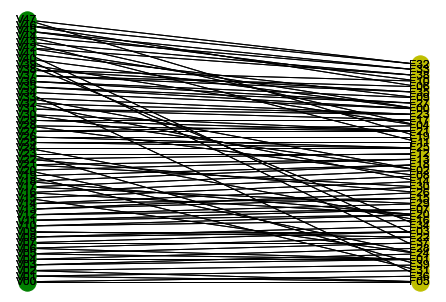

In [19]:
# reognize the different nodes
top_nodes = []
bottom_nodes = []

for item, bipartite in lanepartBipartite.nodes(data=True):
#     print(bipartite)
    if bipartite['bipartite']==0:
        top_nodes.append(item)
    else:
        bottom_nodes.append(item)

pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate((np.array(top_nodes, dtype = '<U8'))) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate((np.array(bottom_nodes, dtype = '<U8'))) ) # put nodes from Y at x=2
nx.draw(lanepartBipartite, pos, nodelist= top_nodes, node_color='g',  with_labels = True)
nx.draw(lanepartBipartite, pos, nodelist= bottom_nodes, node_color='y',  with_labels = True)
plt.show()

In [20]:
# nx.write_gpickle(lanepartBipartite, "BipartiteLondon.gpickle")

In [21]:
lanepartBipartite.nodes

NodeView(('V00', 'F05', 'F36', 'V01', 'F31', 'V02', 'F39', 'V03', 'F01', 'F24', 'V04', 'F28', 'V05', 'F37', 'V06', 'F22', 'V07', 'F03', 'V08', 'F34', 'V09', 'V10', 'F16', 'F20', 'V11', 'F07', 'V12', 'F29', 'V13', 'F15', 'F26', 'V14', 'F30', 'V15', 'F14', 'V16', 'F08', 'V17', 'F02', 'V18', 'F18', 'V19', 'V20', 'F13', 'V21', 'V22', 'F12', 'V23', 'V24', 'F25', 'V25', 'F11', 'V26', 'F19', 'V27', 'F21', 'F04', 'V28', 'V29', 'F17', 'V30', 'V31', 'F23', 'V32', 'V33', 'V34', 'F00', 'V35', 'F27', 'V36', 'F09', 'V37', 'F35', 'F06', 'V38', 'F10', 'V39', 'V40', 'V41', 'V42', 'F38', 'V43', 'V44', 'F33', 'V45', 'V46', 'F32', 'V47'))

In [22]:
neigbours = []

for node in lanepartBipartite.nodes:
    if node[0]=="F":
        factors = [n for n in lanepartBipartite.neighbors(node)]

        print(factors)

['V00', 'V01', 'V02']
['V00', 'V34']
['V01', 'V19']
['V02', 'V23']
['V03', 'V04', 'V05', 'V06']
['V03', 'V15', 'V20']
['V04', 'V40']
['V05', 'V07']
['V06', 'V09', 'V41']
['V07', 'V08', 'V09']
['V08', 'V39']
['V10', 'V24']
['V10', 'V11', 'V16', 'V18']
['V11', 'V12']
['V12', 'V17']
['V13', 'V14']
['V13', 'V22']
['V14', 'V21']
['V15', 'V32']
['V16', 'V28']
['V17', 'V30', 'V33']
['V18', 'V19']
['V20', 'V21']
['V22', 'V23']
['V24', 'V25', 'V26']
['V25', 'V43']
['V26', 'V47']
['V27', 'V28', 'V29', 'V30']
['V27', 'V39', 'V44']
['V29', 'V31']
['V31', 'V32', 'V33']
['V34', 'V35', 'V40', 'V42']
['V35', 'V36']
['V36', 'V41']
['V37', 'V38']
['V37', 'V46']
['V38', 'V45']
['V42', 'V43']
['V44', 'V45']
['V46', 'V47']


In [23]:
neigbours = []

for node in lanepartBipartite.nodes:
    if node[0]=="V":
        factors = [n for n in lanepartBipartite.neighbors(node)]
        
        components = []
        for f in factors:
            
            for n in lanepartBipartite.neighbors(f):
                components.append(n)
        print(components)
        neigbours.append(len(components))

['V00', 'V01', 'V02', 'V00', 'V34']
['V00', 'V01', 'V02', 'V01', 'V19']
['V00', 'V01', 'V02', 'V02', 'V23']
['V03', 'V04', 'V05', 'V06', 'V03', 'V15', 'V20']
['V03', 'V04', 'V05', 'V06', 'V04', 'V40']
['V03', 'V04', 'V05', 'V06', 'V05', 'V07']
['V03', 'V04', 'V05', 'V06', 'V06', 'V09', 'V41']
['V07', 'V08', 'V09', 'V05', 'V07']
['V07', 'V08', 'V09', 'V08', 'V39']
['V07', 'V08', 'V09', 'V06', 'V09', 'V41']
['V10', 'V24', 'V10', 'V11', 'V16', 'V18']
['V11', 'V12', 'V10', 'V11', 'V16', 'V18']
['V11', 'V12', 'V12', 'V17']
['V13', 'V14', 'V13', 'V22']
['V13', 'V14', 'V14', 'V21']
['V15', 'V32', 'V03', 'V15', 'V20']
['V16', 'V28', 'V10', 'V11', 'V16', 'V18']
['V17', 'V30', 'V33', 'V12', 'V17']
['V18', 'V19', 'V10', 'V11', 'V16', 'V18']
['V18', 'V19', 'V01', 'V19']
['V20', 'V21', 'V03', 'V15', 'V20']
['V20', 'V21', 'V14', 'V21']
['V22', 'V23', 'V13', 'V22']
['V22', 'V23', 'V02', 'V23']
['V10', 'V24', 'V24', 'V25', 'V26']
['V25', 'V43', 'V24', 'V25', 'V26']
['V26', 'V47', 'V24', 'V25', 'V26']


In [24]:
len(neigbours)

48

In [25]:
max(neigbours)

7

# Dataset

In [26]:
import pickle as pkl

# with open('IN_OUT.pkl', 'rb') as f:
#     data = pkl.load(f)
    
with open('IN_OUT_weekends.pkl', 'rb') as f:
    data = pkl.load(f)

In [27]:
data_lane_train = {}

data_lane_train["IN"] = {}
data_lane_train["OUT"] = {}

for node in lanepartgraph.nodes:
    data_lane_train["IN"][node]  = data["IN"][node][0:435] 
    data_lane_train["OUT"][node] = data["OUT"][node][0:435]

In [28]:
data_lane_test = {}

data_lane_test["IN"] = {}
data_lane_test["OUT"] = {}

for node in lanepartgraph.nodes:
    data_lane_test["IN"][node]  = data["IN"][node][435:]
    data_lane_test["OUT"][node] = data["OUT"][node][435:]

In [29]:
Y_dict_train = {}

for f in list(F.values()):
    
    if Stations_full[f][-6:] == 'Inflow':
        
        Y_dict_train[f] = data_lane_train["IN"][Stations[f]]
        
    else:
        
        Y_dict_train[f] = data_lane_train["OUT"][Stations[f]]

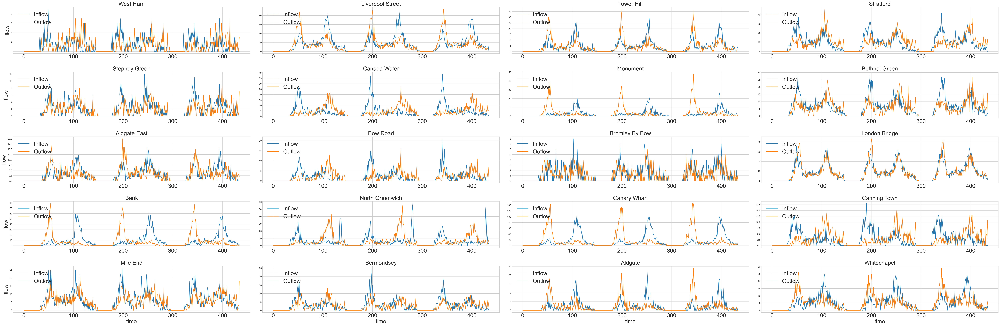

In [30]:
fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=5, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])

i = 0
j = 0
for station in data_lane_train["IN"].keys():
    
    if j == 4:
        j = 0 
        i = i+1
        
    if j ==0:
        ax[i,j].set_ylabel('flow',fontsize=24)
    
    if i==4:
        ax[i,j].set_xlabel('time',fontsize=24)
    
    ax[i,j].plot(data_lane_train["IN"][station][0:], label = "Inflow")
    ax[i,j].plot(data_lane_train["OUT"][station][0:], label = "Outlow")
    ax[i,j].set_title(station, fontsize=24)
    ax[i,j].xaxis.set_tick_params(labelsize=24)
    
    ax[i,j].legend(loc = "upper left", fontsize = 24)
    
    j = j+1
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\inflowOutflowData.eps', format='eps', dpi = 200, bbox_inches='tight')

In [31]:
# Y_dict_train = {}

# for f in list(F.values()):
    
#     if Stations_full[f][-6:] == 'Inflow':
        
#         Y_dict_train[f] = data_lane_train["IN"][Stations[f]]
        
#     else:
        
#         Y_dict_train[f] = data_lane_train["OUT"][Stations[f]]
        
# YT_train = np.zeros( (len(list(Y_dict_train.values())[0]), len(list(Y_dict_train.values()))) )

# for key in list(Y_dict_train.keys()):
    
#     YT_train[:, int(key[1:])] = Y_dict_train[key]
    
# np.save("YT_train.npy", YT_train)

In [32]:
# Y_dict_test = {}

# for f in list(F.values()):
    
#     if Stations_full[f][-6:] == 'Inflow':
        
#         Y_dict_test[f] = data_lane_test["IN"][Stations[f]]
        
#     else:
        
#         Y_dict_test[f] = data_lane_test["OUT"][Stations[f]]
        
# YT_test = np.zeros( (len(list(Y_dict_test.values())[0]), len(list(Y_dict_test.values()))) )

# for key in list(Y_dict_test.keys()):
    
#     YT_test[:, int(key[1:])] = Y_dict_test[key]
    
# np.save("YT_test_weekends.npy", YT_test)

In [33]:
YT_train = np.load("YT_train.npy")
# YT_test  = np.load("YT_test.npy")
YT_test  = np.load("YT_test_weekends.npy")


In [34]:
pkl_file = open('names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

In [35]:
F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]


In [36]:
Stations

{'F00': 'Mile End',
 'F01': 'Liverpool Street',
 'F02': 'Aldgate East',
 'F03': 'Tower Hill',
 'F04': 'Bank',
 'F05': 'West Ham',
 'F06': 'Canary Wharf',
 'F07': 'Stepney Green',
 'F08': 'Bethnal Green',
 'F09': 'Whitechapel',
 'F10': 'Bermondsey',
 'F11': 'Bromley By Bow',
 'F12': 'North Greenwich',
 'F13': 'London Bridge',
 'F14': 'Monument',
 'F15': 'Canada Water',
 'F16': 'Stratford',
 'F17': 'Aldgate',
 'F18': 'Bow Road',
 'F19': 'Canning Town',
 'F20': 'Mile End',
 'F21': 'Liverpool Street',
 'F22': 'Aldgate East',
 'F23': 'Tower Hill',
 'F24': 'Bank',
 'F25': 'West Ham',
 'F26': 'Canary Wharf',
 'F27': 'Stepney Green',
 'F28': 'Bethnal Green',
 'F29': 'Whitechapel',
 'F30': 'Bermondsey',
 'F31': 'Bromley By Bow',
 'F32': 'North Greenwich',
 'F33': 'London Bridge',
 'F34': 'Monument',
 'F35': 'Canada Water',
 'F36': 'Stratford',
 'F37': 'Aldgate',
 'F38': 'Bow Road',
 'F39': 'Canning Town'}

In [37]:
import numpy
import matplotlib.pyplot as plt
import pandas
import math
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

In [38]:
physical_devices = tf.config.list_physical_devices('GPU') 
tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [39]:
# normalize the dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(YT_train)

In [40]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, :])
    return numpy.array(dataX), numpy.array(dataY)

In [41]:
# reshape into X=t and Y=t+1
look_back = 1
trainX, trainY = create_dataset(dataset, look_back)

# trainX = numpy.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))

In [42]:
# normalize the dataset
scaler_test = MinMaxScaler(feature_range=(0, 1))
dataset_test = scaler.fit_transform(YT_test)

In [43]:
# reshape into X=t and Y=t+1
testX, testY = create_dataset(dataset_test, look_back)

# trainX = numpy.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))

In [44]:
trainY.shape

(434, 40)

In [45]:
# # create and fit the LSTM network

# performance = [] 

# for i in range(0, 10):
#     print("ITER ", i)
    
#     model = Sequential()
#     model.add(LSTM(10, input_shape=(1, 40)))
#     model.add(Dense(40))
#     model.compile(loss='mean_squared_error', optimizer='adam')
#     model.fit(trainX, trainY, epochs=100, batch_size=1, verbose=2)
    
#     # make predictions
#     testPredict = model.predict(testX)

#     # invert predictions
#     testPredict = scaler.inverse_transform(testPredict)
#     testY_inv = scaler.inverse_transform(testY)

#     # calculate root mean squared error
#     testScore = math.sqrt(mean_squared_error(testY_inv, testPredict))
#     performance.append(testScore)

In [46]:
# print(r"RMSE for an LST with 40 hidden units (3280 parameters): "+str(np.mean(performance))+" plus/minus "+str(np.std(performance)))

RMSE for an LST with 10 hidden units (860 parameters): 4.40229409816993 $\pm$ 0.12350205293070453

RMSE for an LST with 12 hidden units (1012 parameters): 4.513941981815362 $\pm$ 0.08804469189567213

RMSE for an LST with 40 hidden units (3280 parameters): 4.701679755199348 $\pm$ 0.1091186236774747

In [47]:
# LSTM_alg = {}

# for i in range(100):
#     print("####################################")
#     print("Iter ", i)
#     print("####################################")
#     LSTM_alg[str(i)] = Sequential()
#     LSTM_alg[str(i)].add(LSTM(10, input_shape=(1, 40)))
#     LSTM_alg[str(i)].add(Dense(40))
#     LSTM_alg[str(i)].compile(loss='mean_squared_error', optimizer='adam')
#     LSTM_alg[str(i)].fit(trainX, trainY, epochs=100, batch_size=1, verbose=2)

In [48]:
# for LSTM_key in LSTM_alg:
#     path = 'LSTM-trained\LSTM'+LSTM_key
#     LSTM_alg[LSTM_key].save(path)


In [49]:
from tensorflow import keras

LSTM_alg = {}

for LSTM_key in range(100):
    print(LSTM_key)
    path = 'LSTM-trained\LSTM'+str(LSTM_key)
    LSTM_alg[str(LSTM_key)] = keras.models.load_model(path)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


In [51]:
LSTM_alg[str(LSTM_key)].summary()

Model: "sequential_99"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_99 (LSTM)               (None, 10)                2040      
_________________________________________________________________
dense_99 (Dense)             (None, 40)                440       
Total params: 2,480
Trainable params: 2,480
Non-trainable params: 0
_________________________________________________________________


In [45]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(100):
    starting_time = 0
    ending_time = 290

    # make predictions
    testPredict = LSTM_alg[str(i)].predict(testX[starting_time:ending_time,:,:])

    # invert predictions
    testPredict = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[starting_time:ending_time])
    
    testPredict_list.append(testPredict)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict))
    # testScore_lhalf = np.square(np.mean( np.sqrt(np.abs(testY_inv-testPredict))))
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

print("RMSE "+ str(np.mean(testScore_RMSE))+"+/-"+str(np.std(testScore_RMSE)) )
print("ABS-metric "+ str(np.mean(testScore_abs))+"+/-"+str(np.std(testScore_abs)) )
# print("L(1/2)-metric ", testScore_lhalf)

RMSE 4.638905799075229+/-0.13822959579654537
ABS-metric 2.4561294372398743+/-0.053347149116445045


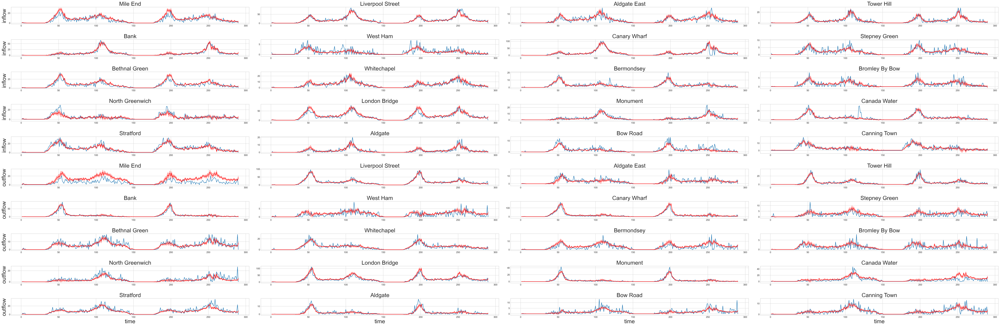

In [46]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
                
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        j = j+1

fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMprediction_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

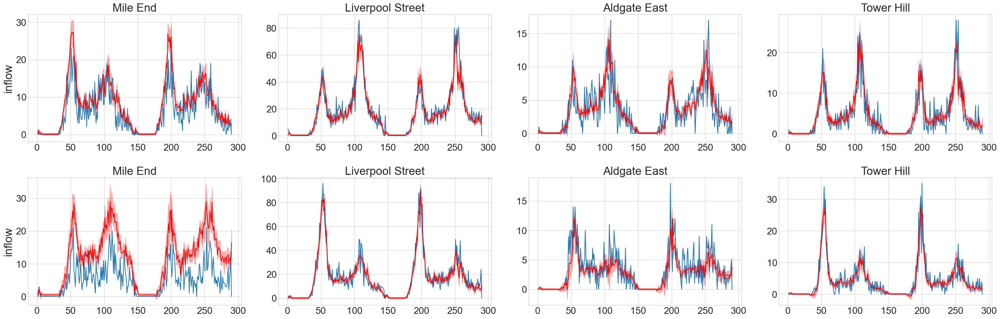

In [47]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
                
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        j = j+1

fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMprediction.pdf', format='pdf', dpi = 100, bbox_inches='tight')

# Missing data 1-step-ahead

## Window with decreasing flow

In [52]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(100):
#     print(i)
    start_missing_data_time = 130
    number_missing_data = 40
    ending_time=290

    # make predictions
    testPredict =  np.zeros((ending_time, testX.shape[2]))
    testPredict[:start_missing_data_time,:] = LSTM_alg[str(i)].predict(testX[starting_time:start_missing_data_time,:,:])

    for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
        testPredict[time,:] = LSTM_alg[str(i)].predict( testPredict[time-1,:].reshape(1,1,40) )

    testPredict[start_missing_data_time + number_missing_data:ending_time,:] = LSTM_alg[str(i)].predict(testX[start_missing_data_time + number_missing_data:ending_time,:,:])

    # invert predictions
    testPredict_norm = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[:ending_time])
    
    testPredict_list.append(testPredict_norm)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict_norm) )
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

print("RMSE "+str(np.mean(testScore_RMSE))+"+/-"+str(np.std(testScore_RMSE)))
print("ABS-metric "+str(np.mean(testScore_abs))+"+/-"+str(np.std(testScore_abs)))

RMSE 7.426845776223445+/-2.080555225002534
ABS-metric 3.5847734388486963+/-0.6454130841425563


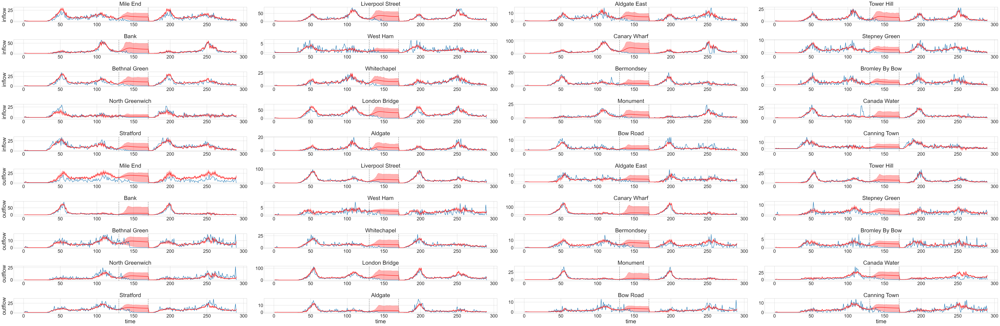

In [53]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMpredictionmissingnopeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

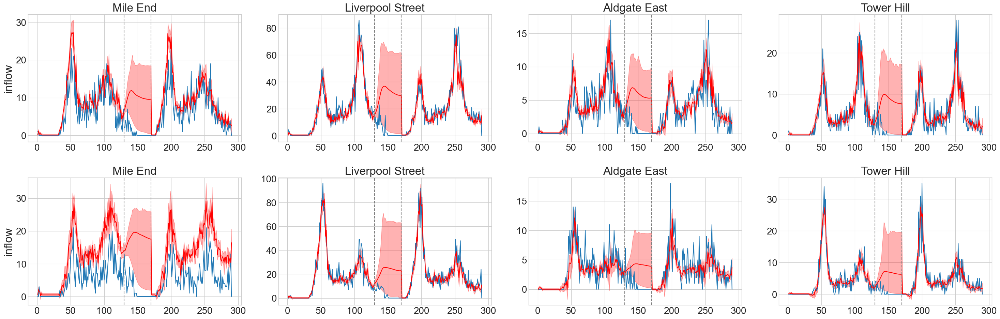

In [54]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMpredictionmissingnopeak.pdf', format='pdf', dpi = 100, bbox_inches='tight')

## Window with peak 

In [55]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(100):
    start_missing_data_time = 230
    number_missing_data = 40

    # make predictions
    testPredict =  np.zeros((ending_time, testX.shape[2]))
    testPredict[:start_missing_data_time,:] = LSTM_alg[str(i)].predict(testX[starting_time:start_missing_data_time,:,:])

    for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
        testPredict[time,:] = LSTM_alg[str(i)].predict( testPredict[time-1,:].reshape(1,1,40) )

    testPredict[start_missing_data_time + number_missing_data:ending_time,:] = LSTM_alg[str(i)].predict(testX[start_missing_data_time + number_missing_data:ending_time,:,:])

    # invert predictions
    testPredict_norm = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[:ending_time])
    
    testPredict_list.append(testPredict_norm)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict_norm) )
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

print("RMSE "+str(np.mean(testScore_RMSE))+"+/-"+str(np.std(testScore_RMSE)))
print("ABS-metric "+str(np.mean(testScore_abs))+"+/-"+str(np.std(testScore_abs)))

RMSE 6.177673806135824+/-1.425000047287146
ABS-metric 2.8780231820519395+/-0.3564128244491962


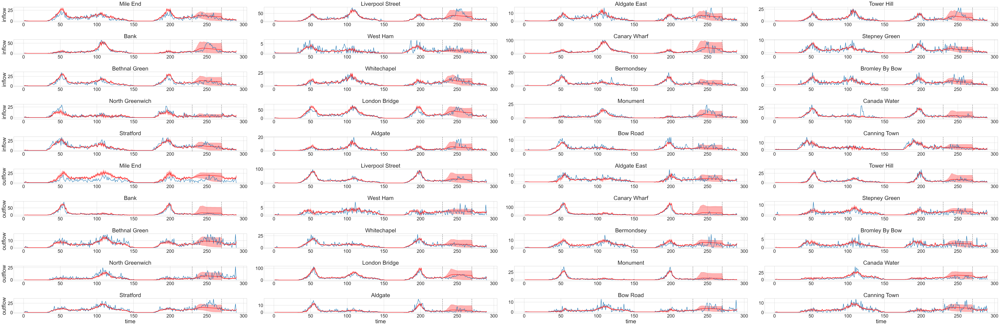

In [57]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time[:ending_time], testY_inv[:ending_time,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMpredictionmissingwithpeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

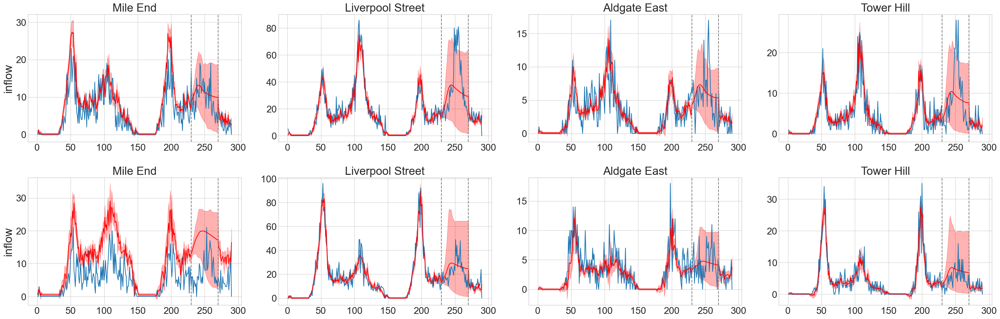

In [59]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time[:ending_time], testY_inv[:ending_time,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMpredictionmissingwithpeak.pdf', format='pdf', dpi = 100, bbox_inches='tight')

## 10-step-ahead

In [89]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(100):
    starting_time = 0
    start_missing_data_time = 200
    number_missing_data = 20

    # make predictions
    testPredict =  np.zeros((testX.shape[0], testX.shape[2]))
    testPredict[:start_missing_data_time,:] = LSTM_alg[str(i)].predict(testX[starting_time:start_missing_data_time,:,:])

    for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
        testPredict[time,:] = LSTM_alg[str(i)].predict( testPredict[time-1,:].reshape(1,1,40) )

#     testPredict[start_missing_data_time + number_missing_data:,:] = LSTM_alg[str(i)].predict(testX[start_missing_data_time + number_missing_data:,:,:])

    # invert predictions
    testPredict_norm = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY)
    
    testPredict_list.append(testPredict_norm)

    # calculate root mean squared error
#     testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
#     testScore_abs_i = np.mean( np.abs(testY_inv-testPredict_norm) )
    
#     testScore_RMSE.append(testScore_RMSE_i)
#     testScore_abs.append(testScore_abs_i)

# print("RMSE "+str(np.mean(testScore_RMSE))+"+/-"+str(np.std(testScore_RMSE)))
# print("ABS-metric "+str(np.mean(testScore_abs))+"+/-"+str(np.std(testScore_abs)))

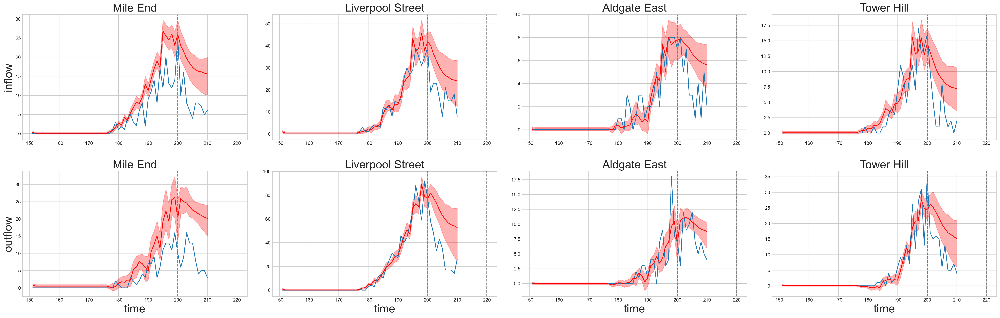

In [90]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=200, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, 210, 210)

zoom = 150

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i == 0:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            if i==1:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==1:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time[zoom:], testY_inv[zoom:210,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time[zoom:], Y_pred_quant[1, zoom:210, name], color=color) 
        ax[i,j].fill_between(time[zoom:], Y_pred_quant[0, zoom:210, name], Y_pred_quant[2, zoom:210, name], alpha = 0.3, color=color ) 



        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\london_LSTMpredictionmissing10step.pdf', format='pdf', dpi = 200, bbox_inches='tight')

# Multi step ahead LSTM 

In [56]:
# normalize the dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(YT_train)

In [57]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, look_back = 1, step_ahead = 1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back- step_ahead+1):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        b = dataset[(i + look_back):(i + look_back + step_ahead), :]
        dataY.append(b.reshape(-1))
    return numpy.array(dataX), numpy.array(dataY)

In [58]:
# reshape into X=t and Y=t+1
look_back  = 1
step_ahead = 40
trainX, trainY = create_dataset(dataset, look_back, step_ahead)

# trainX = numpy.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))

In [59]:
# normalize the dataset
scaler_test = MinMaxScaler(feature_range=(0, 1))
dataset_test = scaler.fit_transform(YT_test)

In [60]:
# reshape into X=t and Y=t+1
testX, testY = create_dataset(dataset_test, look_back, step_ahead)

# trainX = numpy.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))

In [61]:
trainY.shape

(395, 1600)

In [62]:
from tensorflow.keras.layers import TimeDistributed

model_multi = Sequential()
model_multi.add(LSTM(10, input_shape=(look_back, 40)))
model_multi.add(Dense(40*step_ahead))
model_multi.compile(loss='mean_squared_error', optimizer='adam')
model_multi.fit(trainX, trainY, epochs=100, batch_size=1, verbose=2)

Train on 395 samples
Epoch 1/100
395/395 - 3s - loss: 0.0376
Epoch 2/100
395/395 - 1s - loss: 0.0289
Epoch 3/100
395/395 - 1s - loss: 0.0262
Epoch 4/100
395/395 - 1s - loss: 0.0245
Epoch 5/100
395/395 - 1s - loss: 0.0234
Epoch 6/100
395/395 - 1s - loss: 0.0227
Epoch 7/100
395/395 - 2s - loss: 0.0222
Epoch 8/100
395/395 - 1s - loss: 0.0217
Epoch 9/100
395/395 - 1s - loss: 0.0214
Epoch 10/100
395/395 - 2s - loss: 0.0211
Epoch 11/100
395/395 - 1s - loss: 0.0209
Epoch 12/100
395/395 - 1s - loss: 0.0206
Epoch 13/100
395/395 - 1s - loss: 0.0204
Epoch 14/100
395/395 - 1s - loss: 0.0202
Epoch 15/100
395/395 - 1s - loss: 0.0200
Epoch 16/100
395/395 - 1s - loss: 0.0199
Epoch 17/100
395/395 - 1s - loss: 0.0197
Epoch 18/100
395/395 - 2s - loss: 0.0196
Epoch 19/100
395/395 - 1s - loss: 0.0194
Epoch 20/100
395/395 - 1s - loss: 0.0193
Epoch 21/100
395/395 - 1s - loss: 0.0192
Epoch 22/100
395/395 - 1s - loss: 0.0191
Epoch 23/100
395/395 - 1s - loss: 0.0189
Epoch 24/100
395/395 - 1s - loss: 0.0188
Epoc

In [63]:
starting_time = 0

# make predictions
testPredict = model_multi.predict(testX[starting_time:,:,:])
testPredict= testPredict.reshape(540, step_ahead, 40)

# invert predictions
testPredict = scaler.inverse_transform(testPredict[:,4,:])
testY_inv = scaler.inverse_transform(testY.reshape(540, step_ahead, 40)[starting_time:,4,:])

# calculate root mean squared error
testScore_RMSE = np.sqrt( np.mean((testY_inv-testPredict)**2 ))
testScore_abs = np.mean( np.abs(testY_inv-testPredict))
# testScore_lhalf = np.square(np.mean( np.sqrt(np.abs(testY_inv-testPredict))))

print("RMSE ", testScore_RMSE)
print("ABS-metric ", testScore_abs)
# print("L(1/2)-metric ", testScore_lhalf)

RMSE  4.659400288178074
ABS-metric  2.476652505273189


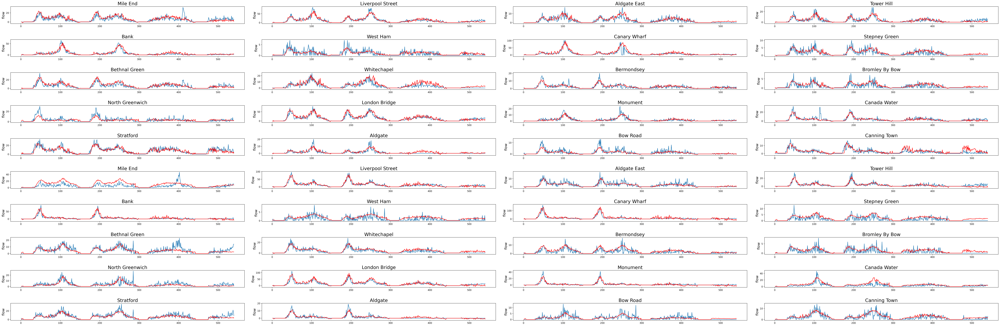

In [64]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"
for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    
    if j == 4:
        j = 0 
        i = i+1
        
#     if i == 5:
#         i = 0
#         color = "Black"
    ax[i,j].set_ylabel('flow',fontsize=15)
    
    zeros = ""
    for k in range(len(str(testPredict.shape[1]))-len(str(name))):
        zeros = zeros + "0"    

    
    ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=20)    
    
#     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),
    
    ax[i,j].plot(time, testY_inv[:,name])

#     ax[i,j].xaxis.set_tick_params(labelsize=12)

    ax[i,j].plot(time, testPredict[:,name], color=color)      
    
    j = j+1
    
fig.tight_layout(pad=3.0)

In [76]:
starting_time = 0
start_missing_data_time = 180
number_missing_data = 40

# make predictions
testPredict =  np.zeros((testX.shape[0], step_ahead, testX.shape[2]))
testPredict[:start_missing_data_time,:,:] = model_multi.predict(testX[starting_time:start_missing_data_time,:,:]).reshape(start_missing_data_time, step_ahead, 40)

# for t in range(number_missing_data):
#     prev = testPredict[start_missing_data_time + t - 1, 1, :].reshape(1, 1, 40)
#     testPredict[start_missing_data_time + t,:,:] = model_multi.predict(prev).reshape(1, step_ahead, 40)

prev = testPredict[start_missing_data_time - 1, :, :].reshape(step_ahead, 1, 40)
testPredict[start_missing_data_time:start_missing_data_time + number_missing_data,:,:] = model_multi.predict(prev).reshape(number_missing_data, step_ahead, 40)
    
testPredict[start_missing_data_time + number_missing_data:,:,:] = model_multi.predict(testX[start_missing_data_time + number_missing_data:,:,:]).reshape(540-(start_missing_data_time + number_missing_data), step_ahead, 40)

# invert predictions
testPredict_norm = scaler.inverse_transform(testPredict[:,0,:])
testY_inv = scaler.inverse_transform(testY.reshape(540, step_ahead, 40)[:,0,:])

# calculate root mean squared error
testScore_RMSE = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
testScore_abs = np.mean( np.abs(testY_inv-testPredict_norm) )

print("RMSE ", testScore_RMSE)
print("ABS-metric ", testScore_abs)

RMSE  4.088240206176824
ABS-metric  2.1955377812393677


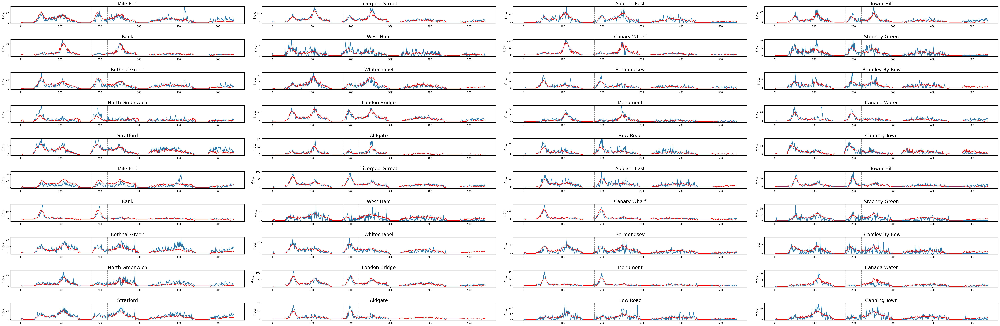

In [77]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"
for name in range(0, testPredict_norm.shape[1]):
    
#     print(i, j)
    
    if j == 4:
        j = 0 
        i = i+1
        
#     if i == 5:
#         i = 0
#         color = "Black"
    ax[i,j].set_ylabel('flow',fontsize=15)
    
    zeros = ""
    for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
        zeros = zeros + "0"    

    
    ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=20)    
    
#     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),
    
    ax[i,j].plot(time, testY_inv[:,name])

#     ax[i,j].xaxis.set_tick_params(labelsize=12)

    ax[i,j].plot(time, testPredict_norm[:,name], color=color)    
    ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
    ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")
    
    j = j+1
    
fig.tight_layout(pad=3.0)

In [ ]:
# size of the hidden variable
nlayers = len({n for n, d in lanepartBipartite.nodes(data=True) if d["bipartite"] == 0})

# Partition choice
trivialpart = dict()

for i in range(0,nlayers):   
    zeros = ""
    for j in range(len(str(nlayers))-len(str(i))):
        zeros = zeros + "0"
    trivialpart[str(i)] = ["V"+zeros+str(i)]

# states
states = [0, 1]

# m 
m = 0

mu0_initial = []
for v in top_nodes:
    mu0_initial.append([1, 0])


# transition kernel
transP_initial = []
for v in top_nodes:
    transP_initial.append(np.array([[0.95, 0.05],
                                    [0.95, 0.05]]) )

# lambda
lambda_initial = []
for f in bottom_nodes:
        lambda_initial.append(1)

# GraphFilterSmootherModule object
GFS = GraphFilterSmoother_C.GraphFilterSmoother_C(lanepartBipartite, states, m, trivialpart, mu0_initial, transP_initial, lambda_initial)


In [ ]:
GFS.preprocessing()

In [ ]:
%run -i EMmulti

In [ ]:
EM = EMmulti_gaussian( GFS, YT_train, 10 )

In [ ]:
lamb_evolution = []
for f in range(len(bottom_nodes)):
    lamb_evolution = []
    for t in range(0,10):
        lamb_evolution.append(EM["lamb_list"][t][f])
    plt.plot(lamb_evolution)

In [ ]:
import time

start = time.time()
pi_filt = GFS.filtering( YT_test )
end = time.time()
print(end - start)

In [ ]:
GFS.lamb

In [ ]:
posterior_mean = GFS.expected_posterior_mean_pred(pi_filt)
maximum_at_posteriori = GFS.maximum_at_posteriori_pred(pi_filt)

In [ ]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(40, 20), dpi=80, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])

i = 0
j = 0
color = "red"
for name in range(0, len(GFS.factors)):
    
#     print(i, j)
    
    if j == 4:
        j = 0 
        i = i+1
        
#     if i == 5:
#         i = 0
#         color = "Black"
    ax[i,j].set_ylabel('flow',fontsize=15)
    
#     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),
    
    ax[i,j].plot(YT_test[:,name])
    
    zeros = ""
    for k in range(len(str(len(lanepartgraph.nodes)))-len(str(name))):
        zeros = zeros + "0"    

    ax[i,j].set_title(Stations["F"+zeros+str(name)]+" "+str(round(GFS.lamb[name], 3)), fontsize=20)
#     ax[i,j].xaxis.set_tick_params(labelsize=12)

    ax[i,j].plot( posterior_mean[name], color=color)    
    ax[i,j].plot( maximum_at_posteriori[name], color=color)    
    
    j = j+1